<a href="https://colab.research.google.com/github/Thevizin/TI0175---INTELIGENCIA-COMPUTACIONAL-APLICADA/blob/main/bivariate_analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [3]:
#importing libraries
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd


In [4]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [5]:
#reading red and white wine datasets and concatenating them to analyze them first separately and then together
df_red=pd.read_csv('/content/drive/My Drive/wine+quality/winequality-red.csv',sep=';')
df_white=pd.read_csv('/content/drive/My Drive/wine+quality/winequality-white.csv',sep=';')
df_concat=pd.concat([df_red,df_white],axis=0)
print("--------------------------------------Red Wine DataFrame Head--------------------------------------: \n", df_red.head())
print("--------------------------------------White Wine DataFrame Head--------------------------------------\n", df_white.head())
print("--------------------------------------Concat dataFrame Head--------------------------------------\n", df_concat.head())


--------------------------------------Red Wine DataFrame Head--------------------------------------: 
    fixed acidity  volatile acidity  citric acid  residual sugar  chlorides  \
0            7.4              0.70         0.00             1.9      0.076   
1            7.8              0.88         0.00             2.6      0.098   
2            7.8              0.76         0.04             2.3      0.092   
3           11.2              0.28         0.56             1.9      0.075   
4            7.4              0.70         0.00             1.9      0.076   

   free sulfur dioxide  total sulfur dioxide  density    pH  sulphates  \
0                 11.0                  34.0   0.9978  3.51       0.56   
1                 25.0                  67.0   0.9968  3.20       0.68   
2                 15.0                  54.0   0.9970  3.26       0.65   
3                 17.0                  60.0   0.9980  3.16       0.58   
4                 11.0                  34.0   0.9978  3.5

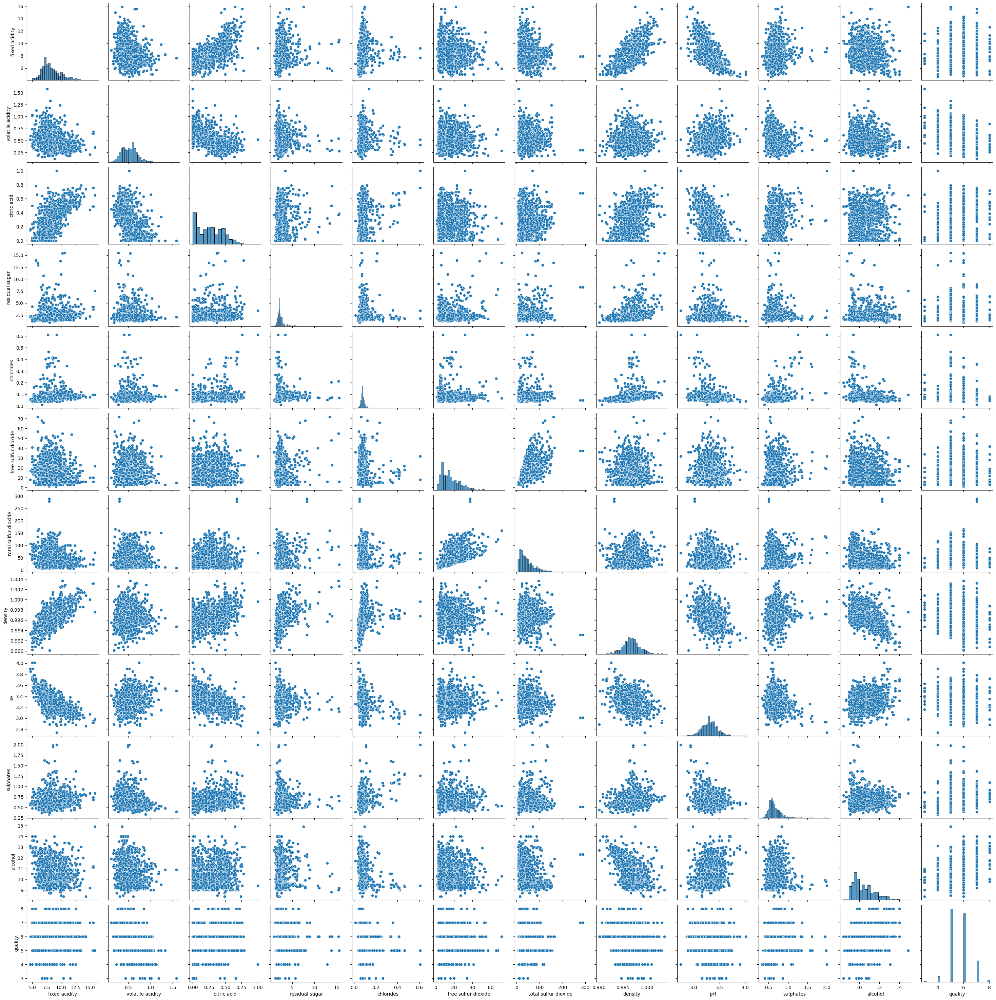

Features of red wine dataset:        fixed acidity  volatile acidity  citric acid  residual sugar  chlorides  \
0               7.4             0.700         0.00             1.9      0.076   
1               7.8             0.880         0.00             2.6      0.098   
2               7.8             0.760         0.04             2.3      0.092   
3              11.2             0.280         0.56             1.9      0.075   
4               7.4             0.700         0.00             1.9      0.076   
...             ...               ...          ...             ...        ...   
1594            6.2             0.600         0.08             2.0      0.090   
1595            5.9             0.550         0.10             2.2      0.062   
1596            6.3             0.510         0.13             2.3      0.076   
1597            5.9             0.645         0.12             2.0      0.075   
1598            6.0             0.310         0.47             3.6      0.067 

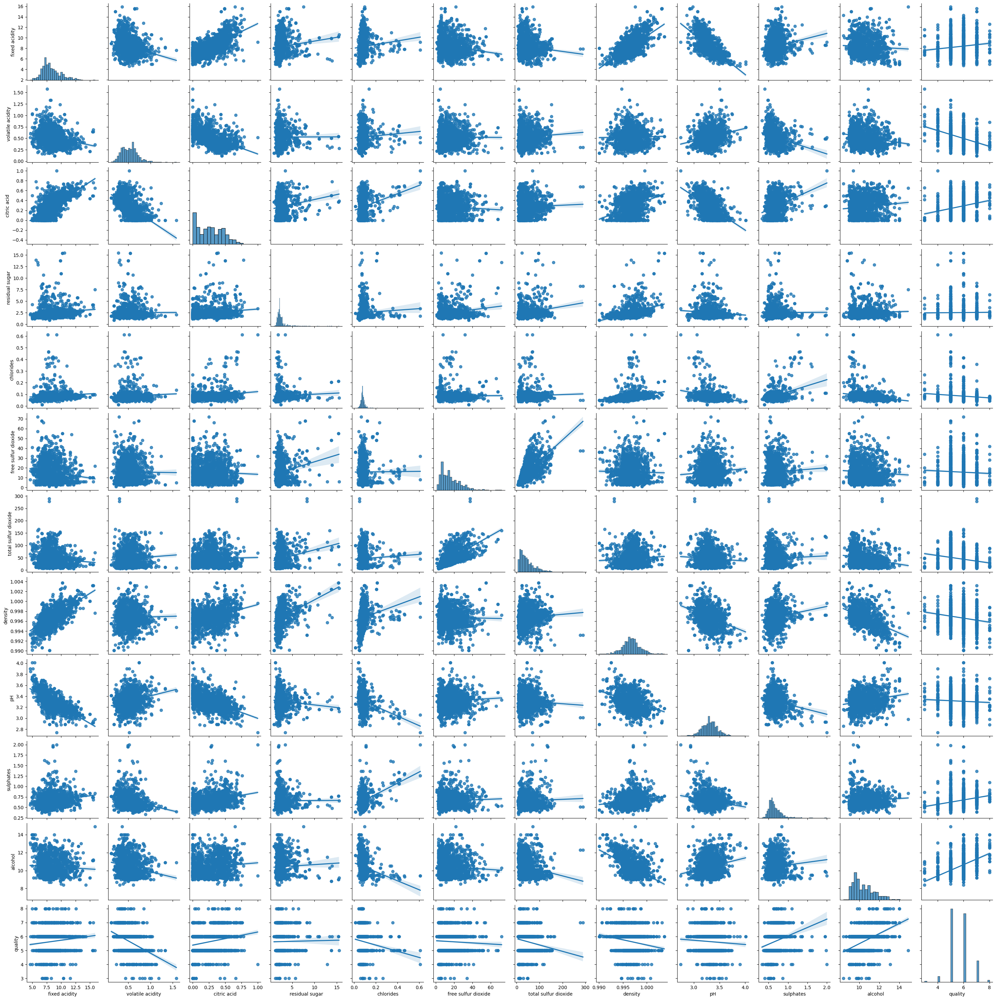

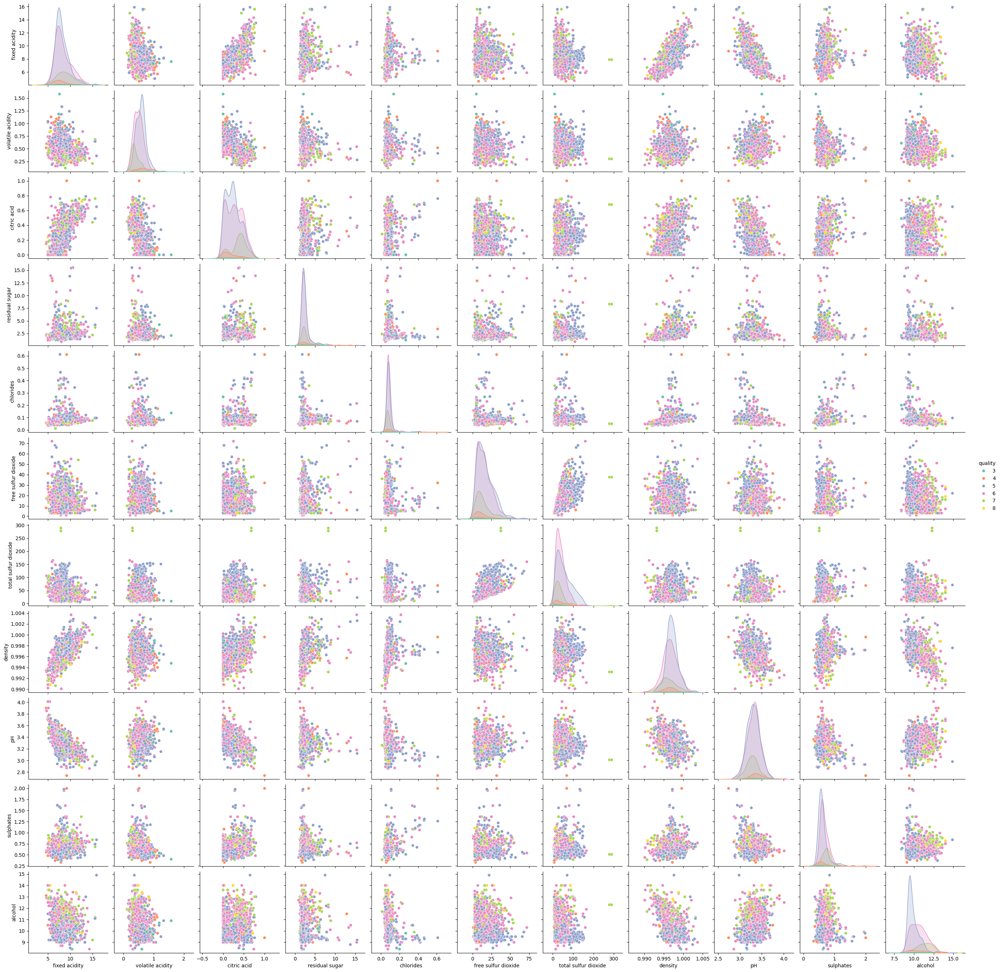

In [6]:
#to start an unconditional bivariate analysis, i'm first goint to plot the scatter plot for all the features of each dataset with different colors for each class of quality
#to see a general idea of the data, i'm going to use a correlogram
#first, we going to se without classes of quality colored

sns.pairplot(df_red,diag_kind="hist")
plt.show()
features_red=df_red.drop(columns=["quality"])
print("Features of red wine dataset: ",features_red)
sns.pairplot(df_red,kind="reg")
plt.show()
#second, we going to see with classes of quality colored
sns.pairplot(df_red, kind="scatter", hue="quality", palette="Set2",diag_kind="kde")
plt.show()

#we can see a relationship between fixed acidity and density and between free sulfur dioxide and total sulfur dioxide and between citric acidity and fixed acidity, analyzing the correlogram of red wine dataset without classes colored
#analyzing the correlogram of red wine dataset with classes colored, we can see perhaps a correlatio between citric acid and density with quality 6. For the wines with quality 7, we can see a correlation fixed acidity and alcohol more clearly
##maybe its worth to drop total sulfor dioxide or free sulfur dioxide, because they seems to be highly correlated


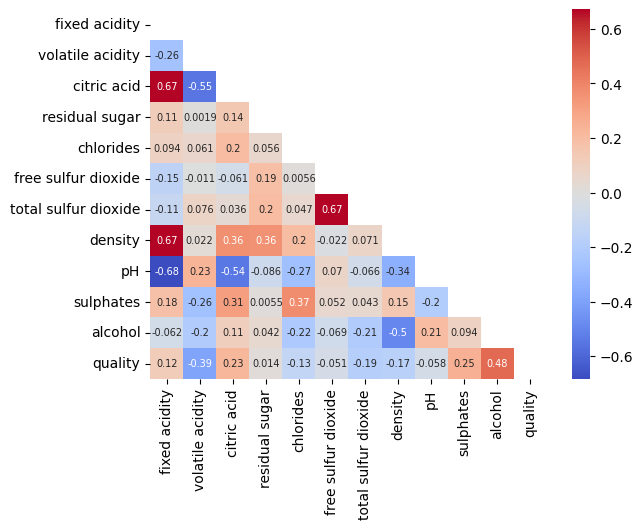

In [7]:
#now, we are going to plot the correlation heat map for the red wine dataset, the correlation matrix shows the
#correlation coefficients between all pairs of features in the dataset without depending on the units of measurement
#the correlation coefficients range from -1 to 1, where 1 indicates a perfect positive correlation, -1 indicates a perfect negative correlation, and 0 indicates no correlation
#we can use the correlation matrix to identify which features are most strongly correlated with each other, and to identify any potential multicollinearity issues in the dataset
corr_matrix=df_red.corr()

# Can be great to plot only a half matrix
# Generate a mask for the upper triangle
mask = np.zeros_like(corr_matrix)
mask[np.triu_indices_from(mask)] = True

sns.heatmap(corr_matrix,cmap="coolwarm",mask=mask, annot=True, annot_kws={"size": 7})
plt.show()

##the heat map confirms the correlation between free sulfur dioxide and total sulfur dioxide, with a correlation coefficient of 0.675
##also, we can see a correlation between citric acid and fixed acidity, with a correlation coefficient of 0.671
##also, we can see a negative correlation between fixed acidity and pH, with a correlation coefficient of -0.687


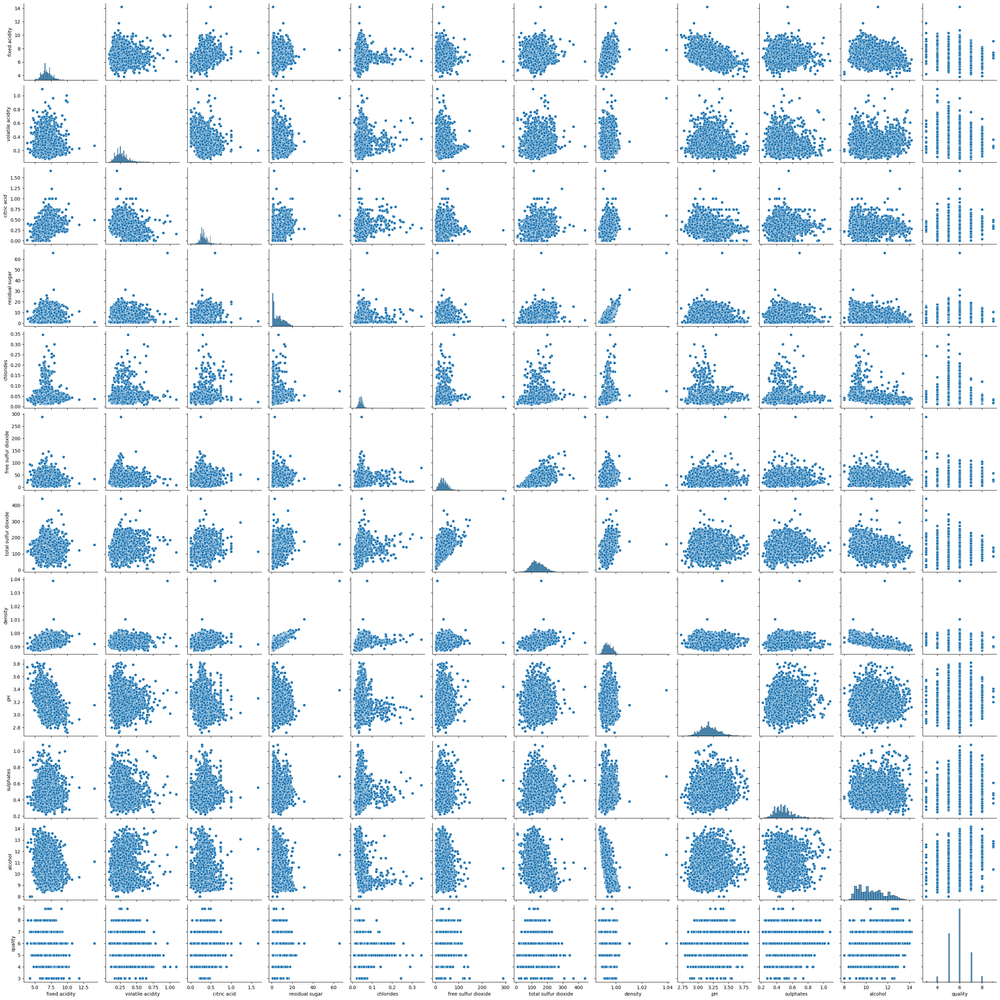

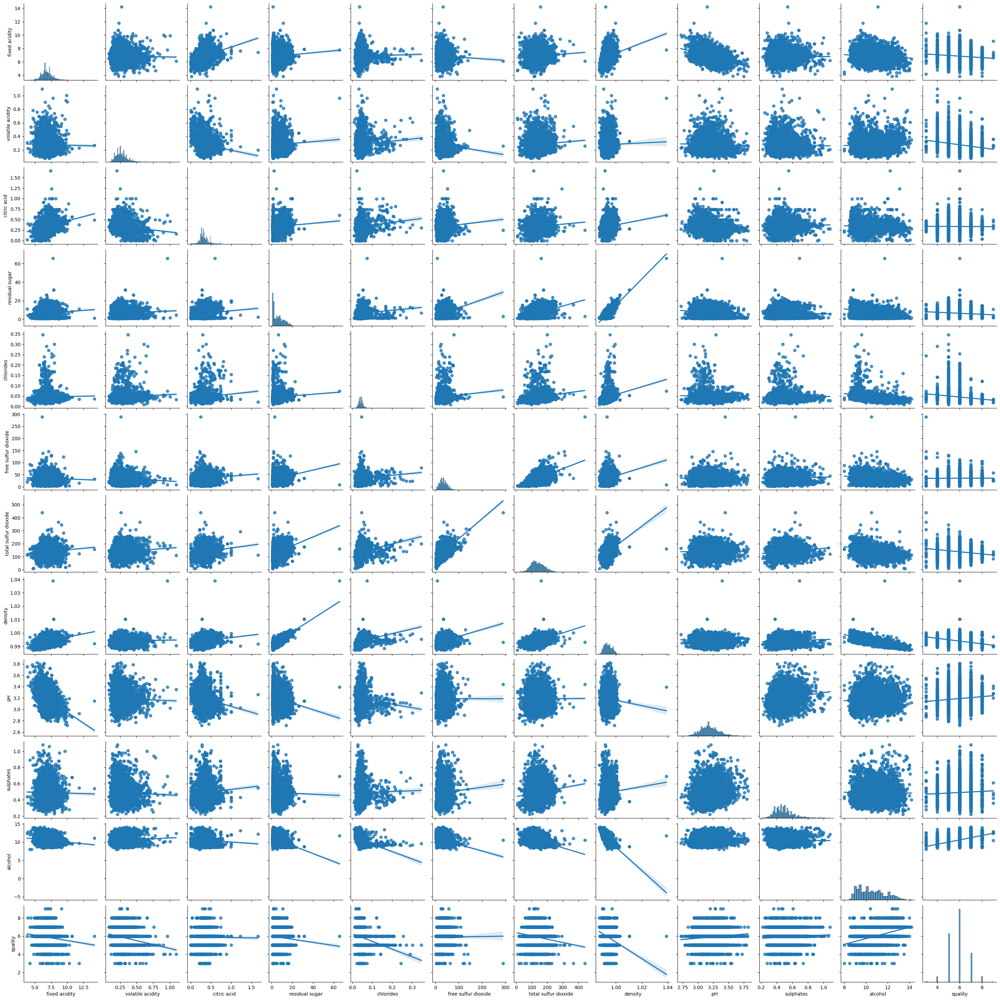

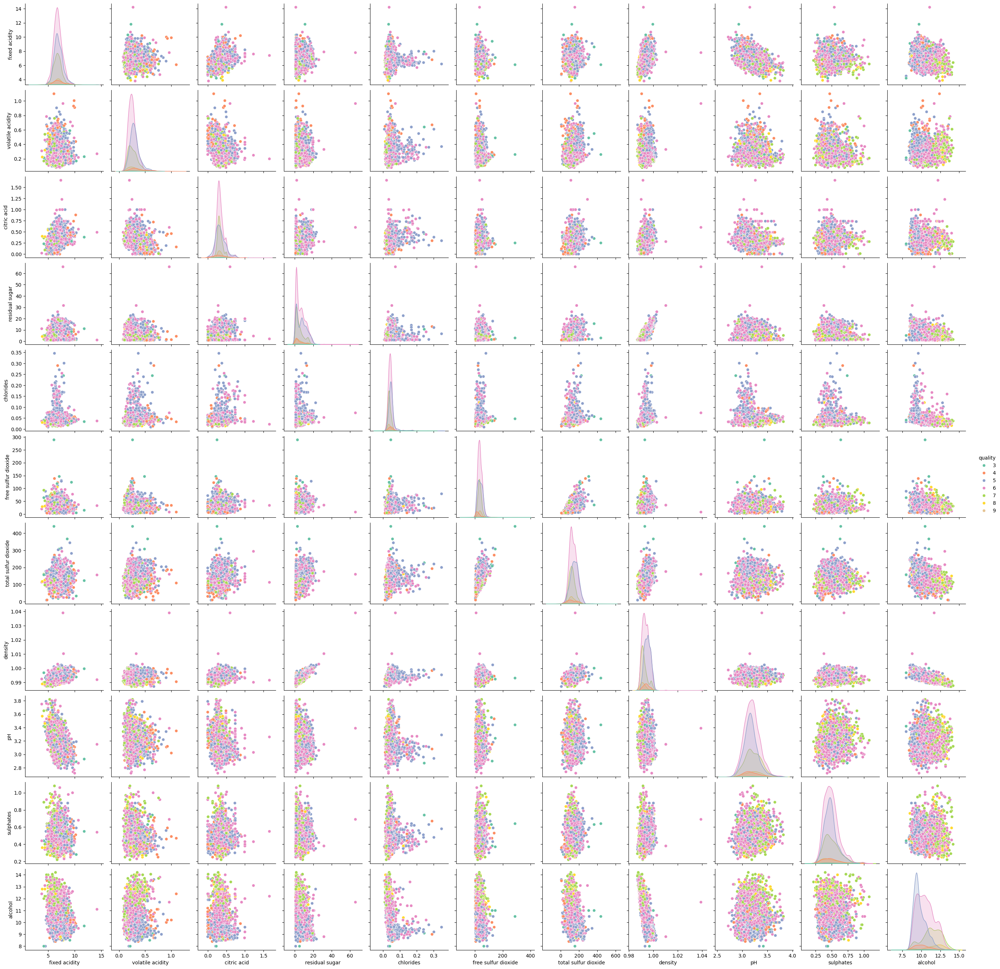

In [8]:
## now, we are going to do the same analysis for the white wine dataset
sns.pairplot(df_white,diag_kind="hist")
plt.show()

sns.pairplot(df_white,kind="reg")
plt.show()
#second, we going to see with classes of quality colored
sns.pairplot(df_white, kind="scatter", hue="quality", palette="Set2",diag_kind="kde")
plt.show()

##after analyzing the correlogram of white wine dataset without classes colored, we can see a relatioship between fixes acidty and citric acid
##and a stronger relationship between residual sugar and density
##also, we can see a relationship between free sulfur dioxide and total sulfur dioxide
##also, we can see a negative correlation between ph and fixed acidity
##also, we can see a negative correlation between alcohol and density
##after analyzing the correlogram of white wine dataset with classes colored, we can see a correlation between fixed acidity aand volatile acidity for quality 4
##
##also, we can see a correlation between volatile acidity and alcohol for quality 5 and 4


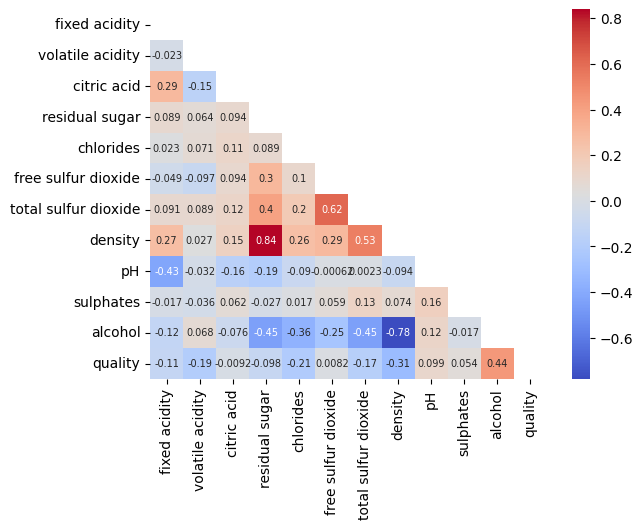

In [9]:
corr_matrix=df_white.corr()

# Can be great to plot only a half matrix
# Generate a mask for the upper triangle
mask = np.zeros_like(corr_matrix)
mask[np.triu_indices_from(mask)] = True

sns.heatmap(corr_matrix,cmap="coolwarm",mask=mask, annot=True, annot_kws={"size": 7})
plt.show()
##with the heat map of white wine dataset, we can confirm the correlation between free sulfur dioxide and total sulfur dioxide, with a correlation coefficient of 0.62
##also, we can confirm the very strong correlation between residual sugar and density, with a correlation coefficient of 0.84. Density seems to be
##a good predictor of residual sugar for white wines
##also, we  can confirm the relationship between desnsity and alcohol, with a correlation coefficient of -0,78
## and between density and total sulfur dioxide, with a correlation coefficient of 0,53


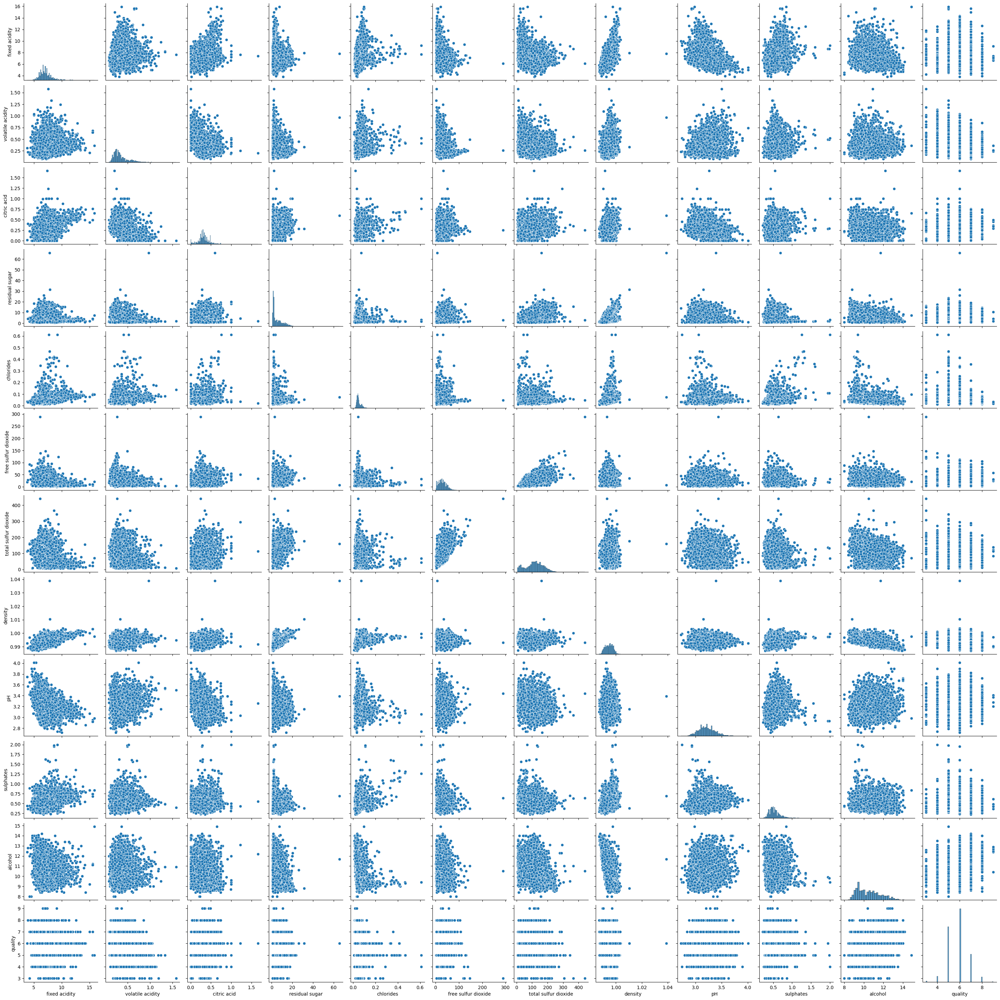

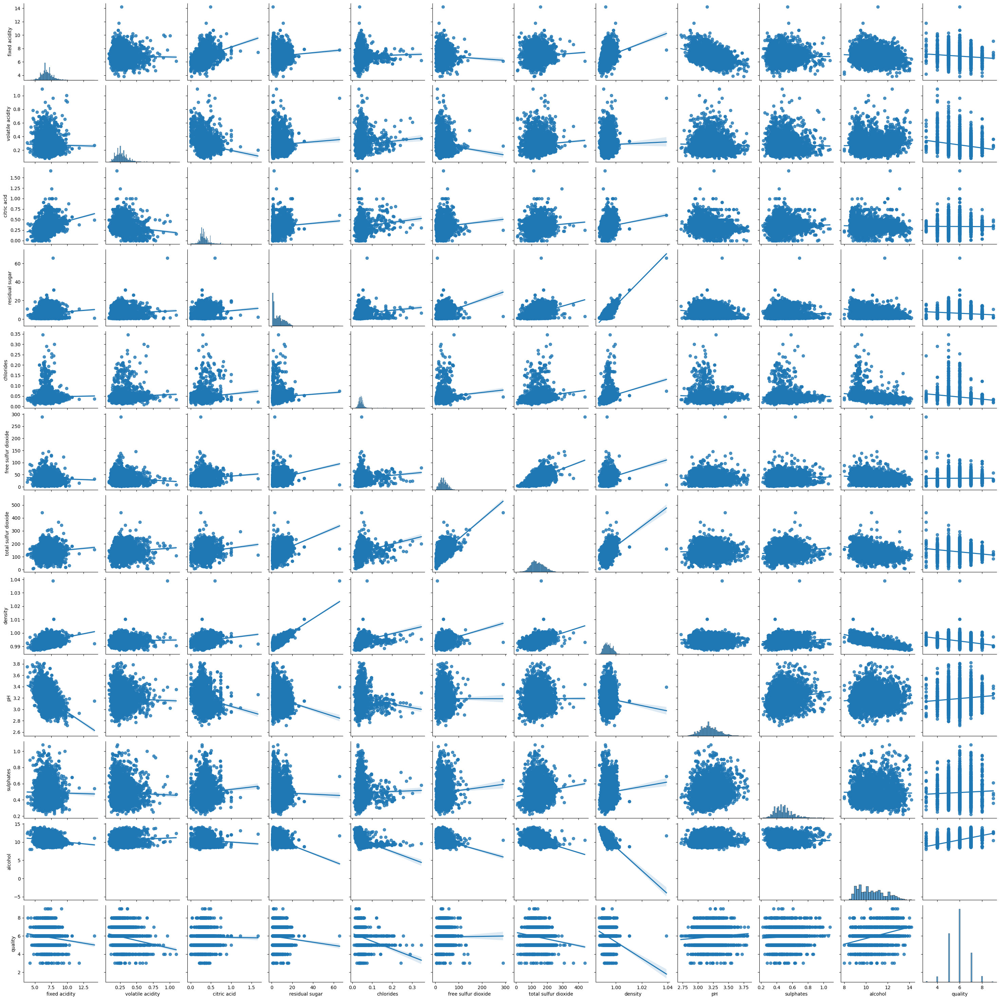

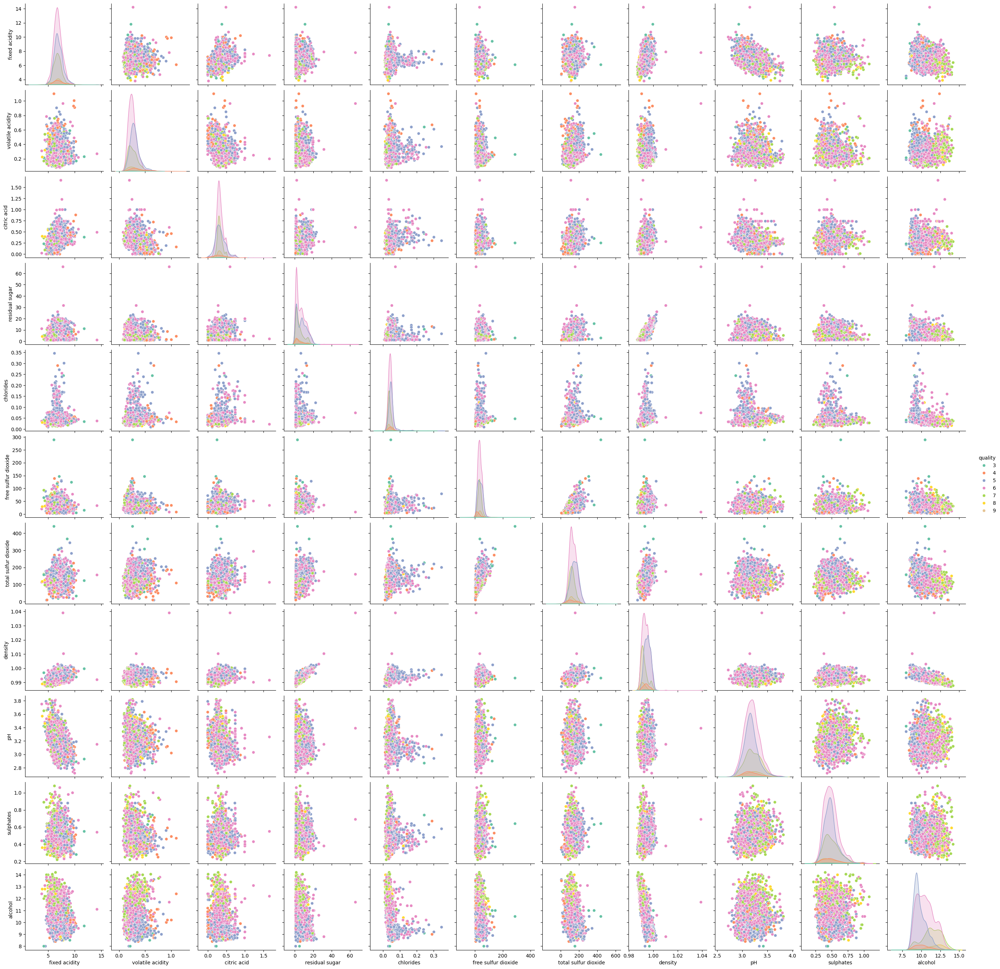

In [10]:
## now, we are going to do the same analysis for the concatenated dataset

sns.pairplot(df_concat,diag_kind="hist")
plt.show()

sns.pairplot(df_white,kind="reg")
plt.show()
#second, we going to see with classes of quality colored
sns.pairplot(df_white, kind="scatter", hue="quality", palette="Set2",diag_kind="kde")
plt.show()

## analyzing the correlogram of concatenated dataset without classes colored, we can see relationships between:
##alcohol and density
##total sulfur dioxide and free sulfur dioxide
## total sulfur dioxide and density
##fixed acidity and citric acid
##fixed acidity and pH (negative correlation)
##fixed acidity and alcohol (negative correlation)
##residual sugar and density


<Axes: >

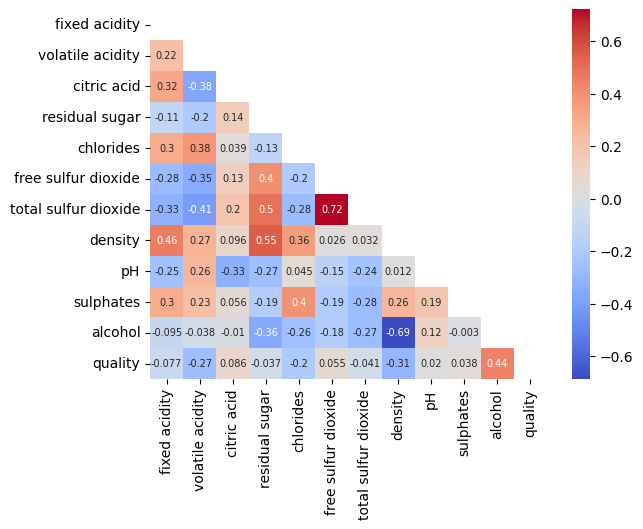

In [11]:
corr_matrix=df_concat.corr()

# Can be great to plot only a half matrix
# Generate a mask for the upper triangle
mask = np.zeros_like(corr_matrix)
mask[np.triu_indices_from(mask)] = True

sns.heatmap(corr_matrix,cmap="coolwarm",mask=mask, annot=True, annot_kws={"size": 7})

##we can confirm the correlation between:
# alcohol and density (correlation coefficient of -0.69)
# total sulfur dioxide and free sulfur dioxide (correlation coefficient of 0.72)
# residual sugar and density (correlation coefficient of 0.55)
# total sulfur dioxide and residual sugar (correlation coefficient of 0.5)


In [ ]:
###CONCLUSIONS
#after doing an unconditional bivariate analysis of the red wine dataset, the white wine dataset and the concatenated dataset, we can see that:
#there are some features that are highly correlated with each other considering all type of wines
#such as free sulfur dioxide and total sulfur dioxide; residual sugar and density; alcohol and density and
# total sulfur dioxide and residual sugar.

#its interesting to point that density and alcohol have a strong negative correlation for white wines(-0.78), but
# for red wines, the correlation is weaker (-0.5), but still significant. Knowing this,the correlation for all types
#  of wines is also strong (-0.69), probaly in decurrence of a bigger number of white wine samples
#the same occurs with residual sugar and density, the correlation is very strong for white wines (0.84),
# but for red wines, its weake (0.36). For all types of wines, the correlation is moderate (0.55),
#  probaly in decurrence of a bigger number of white wine samples
#also, its interesting to point the signifcant correlation between total suffur dioxide and residual sugar (0.5) in
#the concatenated dataset, that is not as strong as in the red wine dataset (0.2) nor in the white wine dataset (0.4)
#also, its interesting to point that fixed acidity and citric acid have a strong correlation for red wines (0.67),
# but for white wines, the correlation is weaker (0.29). Causing a weak correlation for all types of wines (0.32),
# probaly in decurrence of a bigger number of white wine samples as well.
